# Country Level has been almost finished. 

One considerable attempt left is to try LSTM to predict INX of major (extraordinary positive/ negative correlated with sales) industries 



- Miya 10/26/17



**1. Prepare Data**

**2. Correlation between Sales/Core sales and different INX metrics**

**3. Exploratory Analysis on Country Level.**

In [1]:
cd data

/Users/miyainnyc/Documents/mastercard/data


Loading BokehJS ...


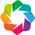

In [2]:
from os import listdir
from os.path import isfile, join
import matplotlib.pyplot as plt
from sklearn import decomposition
from geopy.geocoders import Nominatim

from sklearn.cluster import KMeans
import sklearn.cluster as cluster

from scipy.spatial.distance import cdist


import pandas as pd
import json
import seaborn as sns

from IPython.display import display
from ipywidgets import widgets,interactive
from IPython.display import display, Markdown
from mpl_toolkits.basemap import Basemap

import numpy as np
import math

import requests

%matplotlib inline

import bokeh.io
import bokeh.plotting
import holoviews as hv
import bebi103
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
bokeh.io.output_notebook()
hv.extension('bokeh')

# Prepare Data

## INX

In [3]:
weights = pd.read_csv('Industry_wts.csv')

INX_FIPS_EqlWt_copy = pd.read_table("INX_FIPS_EqlWt_copy.csv.gz",compression='gzip',sep=',')
INX_FIPS_GDVWt_copy = pd.read_table("INX_FIPS_GDVWt_copy.csv.gz",compression='gzip',sep=',')
INX_FIPS_GDVWt_FL = pd.read_table("INX_FIPS_GDVWt_FL.csv.gz",compression='gzip',sep=',')
INX_ST_EqlWt_copy = pd.read_table("INX_ST_EqlWt_copy.csv.gz",compression='gzip',sep=',')
INX_ST_EqlWt_copy_recent = pd.read_table("INX_ST_EqlWt_copy.recent.csv.gz",compression='gzip',sep=',')
INX_ST_GDVWt_copy = pd.read_table("INX_ST_GDVWt_copy.csv.gz",compression='gzip',sep=',')
INX_ST_GDVWt_FL = pd.read_table("INX_ST_GDVWt_FL.csv.gz",compression='gzip',sep=',')
INX_US_EqlWt_copy = pd.read_table("INX_US_EqlWt_copy.csv.gz",compression='gzip',sep=',')
INX_US_GDVWt_copy = pd.read_table("INX_US_GDVWt_copy.csv.gz",compression='gzip',sep=',')

print('amt: total dollar amount')
print('cnt: count of transaction')
print('at: average transction\n')

county = INX_FIPS_EqlWt_copy.merge(INX_FIPS_GDVWt_copy,on = ['TXN_DATE','INDUSTRY','COUNTY_FIPS','STATE_PROVINCE_CODE'], how = 'outer',suffixes= ['_EqlWt','_GDVWt'])
country = INX_US_EqlWt_copy.merge(INX_US_GDVWt_copy,on = ['TXN_DATE','INDUSTRY'], how = 'outer',suffixes= ['_EqlWt','_GDVWt'])
state = INX_ST_EqlWt_copy.merge(INX_ST_GDVWt_copy,on = ['TXN_DATE','INDUSTRY','STATE_PROVINCE_CODE'], how = 'outer',suffixes= ['_EqlWt','_GDVWt'])

country['TXN_DATE'] = pd.to_datetime(country['TXN_DATE'],format='%m/%d/%Y')
state['TXN_DATE'] = pd.to_datetime(state['TXN_DATE'],format='%m/%d/%Y')
county['TXN_DATE'] = pd.to_datetime(county['TXN_DATE'],format='%m/%d/%Y')

## unnormalize country level data

country['YEAR'] = list(map(lambda x:x.year,country['TXN_DATE']))
country = country.merge(weights, on = ['YEAR','INDUSTRY'])
ind_meta = pd.read_csv('industry.codes.csv')
country = country.merge(ind_meta, how = 'left',left_on = 'INDUSTRY',right_on = 'Industry Code')

temp = country.iloc[:,2:8].values/(country['Weight'].values.reshape(country['Weight'].values.shape[0],1))
country_unnormlize = country.copy()
country_unnormlize.iloc[:,2:8] = temp

print('COUNTY:')
print('%d unique days'%len(county['TXN_DATE'].unique()))
print('%d county'%len(county['COUNTY_FIPS'].unique()))
print('%d industry'%len(county['INDUSTRY'].unique()))
print('-------')

print('STATE:')
print('%d unique days'%len(state['TXN_DATE'].unique()))
print('%d state'%len(state['STATE_PROVINCE_CODE'].unique()))
print('%d industry'%len(state['INDUSTRY'].unique()))
print('-------')

print('COUNTRY:')
print('%d unique days'%len(country_unnormlize['TXN_DATE'].unique()))
print('%d industry'%len(country_unnormlize['INDUSTRY'].unique()))
print('-------')

print(county.shape)
print(state.shape)
print(country_unnormlize.shape)


country_monthly = country_unnormlize.copy()
country_monthly["TXN_DATE"] = country_monthly["TXN_DATE"].map(str).map(lambda x:x.split(' ')[0]).map(lambda x:x[:-3])
country_monthly['TXN_DATE'] = pd.to_datetime(country_monthly['TXN_DATE'],format='%Y-%m')
country_monthly = country_monthly.groupby(['INDUSTRY','TXN_DATE']).sum().reset_index().iloc[:,:-2].sort_values(by = 'TXN_DATE')

amt: total dollar amount
cnt: count of transaction
at: average transction

COUNTY:
2981 unique days
1664 county
40 industry
-------
STATE:
2981 unique days
51 state
46 industry
-------
COUNTRY:
2922 unique days
66 industry
-------
(6967537, 10)
(1654407, 9)
(160019, 12)


## Sanity Check

In [4]:
measure_no = 3
measures = ["INX_AMT_EqlWt","INX_CNT_EqlWt","INX_AT_EqlWt","INX_AMT_GDVWt","INX_CNT_GDVWt","INX_AT_GDVWt","Sales"]

display(Markdown("<strong>{}:</strong>".format(measures[measure_no])))

display(Markdown("<strong>Descending Data Missing Ratio by Industry:</strong>"))
print('Some industries have a lot of day records missing')
temp = country_unnormlize[["TXN_DATE","Industry Description",measures[measure_no]]].pivot(index='TXN_DATE', columns="Industry Description", values=measures[measure_no]).sort_index()
print(pd.DataFrame(temp.isnull().sum()).sort_values(0,ascending = False)[:20]/temp.shape[0])

display(Markdown('<strong>Descending Data Missing Ratio by Date:</strong>'))
print('Christmas see high data missing ratio across industries')
print(pd.DataFrame(temp.T.isnull().sum()).sort_values(0,ascending = False)[:20]/temp.shape[1])

<strong>INX_AMT_GDVWt:</strong>

<strong>Descending Data Missing Ratio by Industry:</strong>

Some industries have a lot of day records missing
                                            0
Industry Description                         
Casino and Gambling Activities       0.974333
Warehouse                            0.972621
Photography Services                 0.953114
Live Performances, Events, Exhibits  0.935318
Arts and Craft Stores                0.899384
Florists                             0.821013
College, University Education        0.771389
Dry Cleaning, Laundry Services       0.770363
Specialty Food Stores                0.666324
Real Estate Services                 0.464066
Camera/Photography Supplies          0.442505
Amusement, Recreation Activities     0.429843
Luggage and Leather Stores           0.341889
Cleaning and exterminating Services  0.334360
Construction Services                0.275496
T+E Bus                              0.249829
Equipment Rental                     0.173511
T+E Cruise Lines                     0.170431
Automotive New and Used Car Sa

<strong>Descending Data Missing Ratio by Date:</strong>

Christmas see high data missing ratio across industries
                   0
TXN_DATE            
2010-12-25  0.515152
2011-12-25  0.500000
2009-12-25  0.500000
2012-12-25  0.454545
2013-12-25  0.439394
2009-11-26  0.393939
2009-04-12  0.378788
2011-04-24  0.363636
2010-11-25  0.363636
2009-05-24  0.348485
2010-12-26  0.348485
2010-04-04  0.333333
2010-01-01  0.333333
2010-05-30  0.333333
2009-03-29  0.333333
2009-07-05  0.318182
2011-08-28  0.318182
2009-06-21  0.318182
2009-06-07  0.318182
2014-12-25  0.318182


In [5]:
print('We set industry data missing tolerance being 10%')
temp = country_unnormlize[["TXN_DATE","INDUSTRY",measures[3]]].pivot(index='TXN_DATE', columns='INDUSTRY', values=measures[3]).sort_index()
temp = temp.iloc[:,pd.Series(temp.isnull().sum()/temp.shape[0]<=0.1).values]
print('Fill missing value with backward method')
temp = temp.fillna(method = 'bfill')
print('Fill the rest missing value with median')
temp = temp.fillna(temp.median())
print('Now there are %d missing value'%temp.isnull().sum().sum())

temp = temp.reset_index()
temp['TXN_DATE'] = list(map(lambda x: str(x)[:7], temp['TXN_DATE']))
temp['TXN_DATE'] = pd.to_datetime(temp['TXN_DATE'],format='%Y-%m')
temp = temp.groupby('TXN_DATE').median()

We set industry data missing tolerance being 10%
Fill missing value with backward method
Fill the rest missing value with median
Now there are 0 missing value


In [6]:
print('Save the dataframe for future clustering.\n')
cluster_df_AMT = temp.T

ind_drop_index = [i for i in country_unnormlize['INDUSTRY'].unique() if i not in cluster_df_AMT.index]
ind_drop_desc = country_unnormlize[country_unnormlize['INDUSTRY'].isin(ind_drop_index)]['Industry Description'].unique()

print('So there are %d industries we won\'t do clustering on because of their high missing data ratio.\n\nThey are %s'%(len(ind_drop_index),ind_drop_desc))

Save the dataframe for future clustering.

So there are 20 industries we won't do clustering on because of their high missing data ratio.

They are ['Automotive New and Used Car Sales' 'Amusement, Recreation Activities'
 'Arts and Craft Stores' 'Beer/Wine/Liquor Stores'
 'Cleaning and exterminating Services' 'Casino and Gambling Activities'
 'Construction Services' 'Camera/Photography Supplies'
 'College, University Education' 'Dry Cleaning, Laundry Services'
 'Equipment Rental' 'Florists' 'Specialty Food Stores'
 'Live Performances, Events, Exhibits' 'Luggage and Leather Stores'
 'Photography Services' 'Real Estate Services' 'T+E Bus' 'T+E Cruise Lines'
 'Warehouse']


## CoreRetail

Retail Sales & Food Serv Excl Auto, Gas Stations & Building Materials(SA, Mil.$)


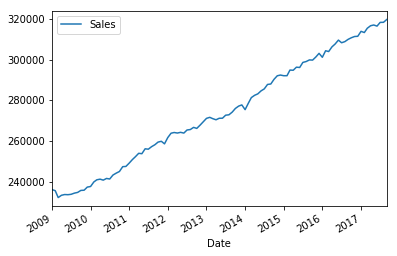

In [9]:
r = requests.get('http://localhost:3000/history?ticker=NRSXMI47@USECON')
print(json.loads(r.text)['descr'])
coreRetail = pd.DataFrame({'Date':list(json.loads(r.text)['data'].keys()),
                           'Sales':list(map(lambda x: int(x),np.squeeze(list(map(lambda x:list(x.values()),list(json.loads(r.text)['data'].values()))))))})
coreRetail['Date'] = pd.to_datetime(coreRetail['Date'],format='%Y-%b')

coreRetail = coreRetail[coreRetail['Date']>='2009-01-01']
coreRetail.set_index('Date').plot()

## Retail

Retail Sales & Food Services Excl Motor Vehicles & Parts Dealers (SA, Mil.$)


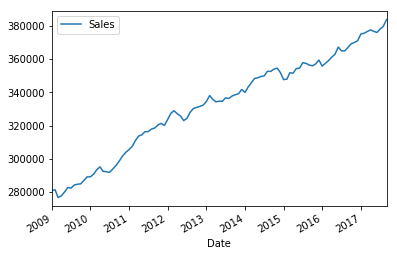

In [10]:
r = requests.get('http://localhost:3000/history?ticker=NRSTXM@USECON')
print(json.loads(r.text)['descr'])
Retail = pd.DataFrame({'Date':list(json.loads(r.text)['data'].keys()),
                           'Sales':list(map(lambda x: int(x),np.squeeze(list(map(lambda x:list(x.values()),list(json.loads(r.text)['data'].values()))))))})
Retail['Date'] = pd.to_datetime(Retail['Date'],format='%Y-%b')

Retail = Retail[Retail['Date']>='2009-01-01']
Retail.set_index('Date').plot()

# INX and Core Retail
* Check Correlation Between Metrics and Sales

In [11]:
coreRetail_m = country_monthly.merge(coreRetail,how = 'left',left_on ='TXN_DATE',right_on = 'Date')

print('Most of the time, six metrics correlate with Sales in a similar way.\n')
print('But occasionally, metrics behave totally differently. For example, for industry BMV, correlation with Sales:\n')
print(coreRetail_m[coreRetail_m['INDUSTRY']=='BMV'].sort_values('Date')[measures].corr().iloc[:-1,-1].sort_values(ascending = False))

Most of the time, six metrics correlate with Sales in a similar way.

But occasionally, metrics behave totally differently. For example, for industry BMV, correlation with Sales:

INX_CNT_EqlWt    0.899376
INX_CNT_GDVWt    0.874509
INX_AMT_EqlWt    0.840270
INX_AMT_GDVWt    0.772234
INX_AT_EqlWt     0.168438
INX_AT_GDVWt    -0.370486
Name: Sales, dtype: float64


In [12]:
print('For some industries, INX highly correlate with Sales. But for some, things are different.\n')
print('EQR:%s'%ind_meta[ind_meta['Industry Code']=='EQR']['Industry Description'].values)
print(coreRetail_m[coreRetail_m['INDUSTRY']=='EQR'].sort_values('Date')[measures].corr().iloc[:-1,-1].sort_values(ascending = False))
print('--------')
print('CGA:%s'%ind_meta[ind_meta['Industry Code']=='CGA']['Industry Description'].values)
print(coreRetail_m[coreRetail_m['INDUSTRY']=='CGA'].sort_values('Date')[measures].corr().iloc[:-1,-1].sort_values(ascending = False))
print('--------')

print('Sometimes, metrics appear polarized correlation. For example:\n')
print('CTS:%s'%ind_meta[ind_meta['Industry Code']=='CTS']['Industry Description'].values)
print(coreRetail_m[coreRetail_m['INDUSTRY']=='CTS'].sort_values('Date')[measures].corr().iloc[:-1,-1].sort_values(ascending = False))

For some industries, INX highly correlate with Sales. But for some, things are different.

EQR:['Equipment Rental']
INX_AT_GDVWt     0.848470
INX_AMT_EqlWt    0.835982
INX_AT_EqlWt     0.808645
INX_AMT_GDVWt    0.806669
INX_CNT_GDVWt    0.792361
INX_CNT_EqlWt    0.777305
Name: Sales, dtype: float64
--------
CGA:['Casino and Gambling Activities']
INX_CNT_GDVWt    0.341940
INX_AMT_GDVWt    0.341937
INX_CNT_EqlWt    0.334083
INX_AMT_EqlWt    0.333364
INX_AT_EqlWt     0.066773
INX_AT_GDVWt     0.054655
Name: Sales, dtype: float64
--------
Sometimes, metrics appear polarized correlation. For example:

CTS:['Communications, Telecommunications, Cable Services']
INX_AMT_GDVWt    0.965365
INX_AMT_EqlWt    0.932924
INX_CNT_GDVWt    0.921244
INX_CNT_EqlWt    0.898281
INX_AT_EqlWt    -0.789634
INX_AT_GDVWt    -0.870464
Name: Sales, dtype: float64


In [13]:
print('You can play with the following interactive chart by yourself and find more insights!!!')

ind = widgets.Dropdown(
    options=sorted(country['Industry Description'].unique()),
    value='Book Stores',
    description='Industry:',
)

def corr_sales(ind):
    print('For industry of [%s], measures correlated with Sales as followings:\n'%ind)
    ind_x = ind_meta[ind_meta['Industry Description']==ind]['Industry Code'].item()
    temp = coreRetail_m[coreRetail_m['INDUSTRY']==ind_x].sort_values('Date')[measures].corr()
    print(temp.iloc[:-1,-1].sort_values(ascending = False))
    temp = coreRetail_m[coreRetail_m['INDUSTRY']==ind_x].sort_values('Date')[measures].corr()
    sns.heatmap(temp,cmap = 'Oranges')

interactive(corr_sales, ind=ind)

You can play with the following interactive chart by yourself and find more insights!!!


A Jupyter Widget

In [14]:
dict_highcor = dict()
for ind in coreRetail_m['INDUSTRY'].unique():
    temp = coreRetail_m[coreRetail_m['INDUSTRY']==ind].sort_values('Date')[measures].corr()
    dict_highcor[ind] = dict(temp.iloc[:-1,-1][abs(temp.iloc[:-1,-1])>0.9])

cnt = 0
high_ind = []
for ind in dict_highcor.keys():
    if len(list(dict_highcor[ind]))>0:
        cnt+=1
        high_ind.append(ind)
        
ind_high_desc = ind_meta[ind_meta['Industry Code'].isin(high_ind)]['Industry Description'].values        
print('There are %d industries have high correlation (>0.9) with Core Retail Sales in terms of at least one measurement.\n'%cnt)
print('They are %s.\n'%ind_high_desc)

cnt = 0
ind_high = []
for ind in dict_highcor.keys():
    if len(list(dict_highcor[ind]))==6:
        cnt+=1
        ind_high.append(ind)
ind_high_desc = ind_meta[ind_meta['Industry Code'].isin(ind_high)]['Industry Description'].values
print('There are %d industries have high correlation (>0.9) with Core Retail Sales in terms of all six measurement. \nThey are %s\n'%(cnt,ind_high_desc))

ind_nega1 = []
for ind in coreRetail_m['INDUSTRY'].unique():
    temp = coreRetail_m[coreRetail_m['INDUSTRY']==ind].sort_values('Date')[measures].corr()
    temp_dict = dict(temp.iloc[:-1,-1])
    for m in temp_dict.keys():
        if temp_dict[m]<-0.5:
            print('Industry %s is highly negatively correlated (%s) with Sales in terms of metric %s'%(ind,temp_dict[m],m))
            ind_nega1.append(ind)

There are 38 industries have high correlation (>0.9) with Core Retail Sales in terms of at least one measurement.

They are ["Children's Apparel" 'Family Apparel' "Men's Apparel" "Women's Apparel"
 'Miscellaneous Apparel' 'Accommodations'
 'Automotive New and Used Car Sales' 'Automotive Retail' 'Book Stores'
 'Beer/Wine/Liquor Stores' 'Consumer Electronics / Appliances'
 'Computer / Software Stores' 'Cosmetics and Beauty Services'
 'Courier Services' 'Communications, Telecommunications, Cable Services'
 'Drug Store Chains' 'Variety / General Merchandise Stores' 'Eating Places'
 'Giftware/Houseware/Card Shops' 'Grocery Stores'
 'Health Care and Social Assistance' 'Home Furnishings / Furniture'
 'Home Improvement Centers' 'Jewelry and Giftware'
 'Miscellaneous entertainment and recreation'
 'Maintenance and Repair Services' 'Optical' 'Office Supply Chains'
 'Software Production, Network Services and Data Processing'
 'Travel Agencies and Tour Operators' 'T+E Airlines' 'T+E Bus'
 'T+E Veh

# Similarly, INX and Retail

In [15]:
Retail_m = country_monthly.merge(Retail,how = 'left',left_on ='TXN_DATE',right_on = 'Date')
measures = ["INX_AMT_EqlWt","INX_CNT_EqlWt","INX_AT_EqlWt","INX_AMT_GDVWt","INX_CNT_GDVWt","INX_AT_GDVWt","Sales"]

ind = widgets.Dropdown(
    options=sorted(country['Industry Description'].unique()),
    value='Book Stores',
    description='Industry:',
)

def corr_sales(ind):
    print('For %s industry, measures correlated with Sales as followings:'%ind)
    ind_x = ind_meta[ind_meta['Industry Description']==ind]['Industry Code'].item()
    temp = Retail_m[Retail_m['INDUSTRY']==ind_x].sort_values('Date')[measures].corr()
    print(temp.iloc[:-1,-1].sort_values(ascending = False))
    sns.heatmap(temp,cmap = 'PuBu')

interactive(corr_sales, ind=ind)

A Jupyter Widget

In [16]:
dict_highcor = dict()
for ind in Retail_m['INDUSTRY'].unique():
    temp = Retail_m[Retail_m['INDUSTRY']==ind].sort_values('Date')[measures].corr()
    dict_highcor[ind] = dict(temp.iloc[:-1,-1][abs(temp.iloc[:-1,-1])>0.9])

cnt = 0
high_ind = []
for ind in dict_highcor.keys():
    if len(list(dict_highcor[ind]))>0:
        cnt+=1
        high_ind.append(ind)
        
ind_high_desc = ind_meta[ind_meta['Industry Code'].isin(high_ind)]['Industry Description'].values        
        
print('There are %d industries have high correlation (>0.9) with Core Retail Sales in terms of at least one measurement.'%cnt)
print('They are %s.'%ind_high_desc)

cnt = 0
ind_high1 = []
for ind in dict_highcor.keys():
    if len(list(dict_highcor[ind]))==6:
        cnt+=1
        ind_high1.append(ind)

ind_high_desc1 = ind_meta[ind_meta['Industry Code'].isin(ind_high1)]['Industry Description'].values        
print('There are %d industries have high correlation (>0.9) with Core Retail Sales in terms of all six measurement. They are %s\n'%(cnt,ind_high_desc1))

ind_nega2 = []
for ind in Retail_m['INDUSTRY'].unique():
    temp = Retail_m[Retail_m['INDUSTRY']==ind].sort_values('Date')[measures].corr()
    temp_dict = dict(temp.iloc[:-1,-1])
    for m in temp_dict.keys():
        if temp_dict[m]<-0.5:
            print('Industry %s is highly negatively correlated (%s) with Sales in terms of metric %s'%(ind,temp_dict[m],m))
            ind_nega2.append(ind)

There are 27 industries have high correlation (>0.9) with Core Retail Sales in terms of at least one measurement.
They are ["Children's Apparel" 'Miscellaneous Apparel'
 'Automotive New and Used Car Sales' 'Automotive Retail'
 'Consumer Electronics / Appliances' 'Computer / Software Stores'
 'Cosmetics and Beauty Services'
 'Communications, Telecommunications, Cable Services' 'Drug Store Chains'
 'Variety / General Merchandise Stores' 'Eating Places'
 'Giftware/Houseware/Card Shops' 'Grocery Stores'
 'Health Care and Social Assistance' 'Home Furnishings / Furniture'
 'Home Improvement Centers' 'Miscellaneous entertainment and recreation'
 'Maintenance and Repair Services' 'Optical' 'Office Supply Chains'
 'Software Production, Network Services and Data Processing' 'T+E Airlines'
 'T+E Bus' 'Utilities' 'Video and Game Rentals' 'Wholesale Clubs'
 'Wholesale Trade'].
There are 1 industries have high correlation (>0.9) with Core Retail Sales in terms of all six measurement. They are ['Main

In [17]:
print('We might have interest in industries highly correlated with either sales or core sales in terms of all six measurement.\n')
print('They are %s %s\n'%(ind_high_desc1,ind_high_desc))
print('Industries high negatively correlated with sales/core sales are all in terms of AT (Average transaction) except RCP whose transaction amount is -52% correlated with sales.')

We might have interest in industries highly correlated with either sales or core sales in terms of all six measurement.

They are ['Maintenance and Repair Services'] ["Children's Apparel" 'Miscellaneous Apparel'
 'Automotive New and Used Car Sales' 'Automotive Retail'
 'Consumer Electronics / Appliances' 'Computer / Software Stores'
 'Cosmetics and Beauty Services'
 'Communications, Telecommunications, Cable Services' 'Drug Store Chains'
 'Variety / General Merchandise Stores' 'Eating Places'
 'Giftware/Houseware/Card Shops' 'Grocery Stores'
 'Health Care and Social Assistance' 'Home Furnishings / Furniture'
 'Home Improvement Centers' 'Miscellaneous entertainment and recreation'
 'Maintenance and Repair Services' 'Optical' 'Office Supply Chains'
 'Software Production, Network Services and Data Processing' 'T+E Airlines'
 'T+E Bus' 'Utilities' 'Video and Game Rentals' 'Wholesale Clubs'
 'Wholesale Trade']

Industries high negatively correlated with sales/core sales are all in terms of 

# INX and Retail and Core Retail

In [18]:
list1 = list(set(['AAC', 'CMP', 'AAF', 'MER', 'COS', 'UTL', 'TOY', 'CTS', 'SND', 'TEV', 'JGS', 'CSV', 'MRS', 'CEA', 'BWL', 'WHT', 'AAW', 'AAX', 'ACC', 'WHC', 'ACS', 'OSC', 'AUT', 'BKS', 'VGR', 'OPT', 'AAM', 'GHC', 'HCS', 'GRO', 'TEB', 'TAT', 'HFF', 'EAP', 'HIC', 'TEA', 'DVG', 'DSC']))
list2 = list(set(['AAC', 'CMP', 'MER', 'COS', 'UTL', 'CTS', 'SND', 'MRS', 'CEA', 'WHT', 'AAX', 'WHC', 'ACS', 'OSC', 'AUT', 'VGR', 'OPT', 'GHC', 'HCS', 'GRO', 'TEB', 'HFF', 'EAP', 'HIC', 'TEA', 'DVG', 'DSC']))

overlap1 = [i for i in list1 if i in list2]
overlap1_desc1 = ind_meta[ind_meta['Industry Code'].isin(overlap1)]['Industry Description'].values        
print('There are %d industries highly correlated with both core retail and retail sales. \nThey are %s.\n' %(len(overlap1_desc1),overlap1_desc1))

ind_nega1 = list(set(ind_nega1))
ind_nega2 = list(set(ind_nega2))

overlap2 = [i for i in ind_nega1 if i in ind_nega2]
overlap2_desc = ind_meta[ind_meta['Industry Code'].isin(overlap2)]['Industry Description'].values        


print('There are %d industries\' AT highly negatively correlated with both core retail and retail sales. \nThey are %s.\n' %(len(overlap2_desc),overlap2_desc))

display(Markdown('Interesting that while <strong>Children\'s Apparel </strong>is \
                 highly POSITIVELY correlated with sales/core sales, <strong>Family Apparel </strong>is \
                 highly NEGATIVELY correlated with sales in temrs of AT (average ssles).'))

There are 27 industries highly correlated with both core retail and retail sales. 
They are ["Children's Apparel" 'Miscellaneous Apparel'
 'Automotive New and Used Car Sales' 'Automotive Retail'
 'Consumer Electronics / Appliances' 'Computer / Software Stores'
 'Cosmetics and Beauty Services'
 'Communications, Telecommunications, Cable Services' 'Drug Store Chains'
 'Variety / General Merchandise Stores' 'Eating Places'
 'Giftware/Houseware/Card Shops' 'Grocery Stores'
 'Health Care and Social Assistance' 'Home Furnishings / Furniture'
 'Home Improvement Centers' 'Miscellaneous entertainment and recreation'
 'Maintenance and Repair Services' 'Optical' 'Office Supply Chains'
 'Software Production, Network Services and Data Processing' 'T+E Airlines'
 'T+E Bus' 'Utilities' 'Video and Game Rentals' 'Wholesale Clubs'
 'Wholesale Trade'].

There are 7 industries' AT highly negatively correlated with both core retail and retail sales. 
They are ['Family Apparel' 'Communications, Telecommunic

Interesting that while <strong>Children's Apparel </strong>is                  highly POSITIVELY correlated with sales/core sales, <strong>Family Apparel </strong>is                  highly NEGATIVELY correlated with sales in temrs of AT (average ssles).

In [19]:
display(Markdown('<strong>You can check correlation for any industry by yourself in the following:</strong>'))

Retail_m = country_monthly.merge(Retail,how = 'left',left_on ='TXN_DATE',right_on = 'Date')
measures = ["INX_AMT_EqlWt","INX_CNT_EqlWt","INX_AT_EqlWt","INX_AMT_GDVWt","INX_CNT_GDVWt","INX_AT_GDVWt","Sales"]

ind = widgets.Dropdown(
    options=sorted(country['Industry Description'].unique()),
    value="Children's Apparel",
    description='Industry:',
)

def corr_sales(ind):
    print('For %s industry, measures correlated with Sales as followings:'%ind)
    ind_x = ind_meta[ind_meta['Industry Description']==ind]['Industry Code'].item()
    temp = Retail_m[Retail_m['INDUSTRY']==ind_x].sort_values('Date')[measures].corr()
    print(temp.iloc[:-1,-1].sort_values(ascending = False))
    sns.heatmap(temp,cmap = 'PuBu')

interactive(corr_sales, ind=ind)

<strong>You can check correlation for any industry by yourself in the following:</strong>

A Jupyter Widget

# EXPLORATORY

# A. COUNTRY LEVEL

## Correlation Between All Industries

Industry Correlation on Different Measures

Industries are extremely high-correlated with each other


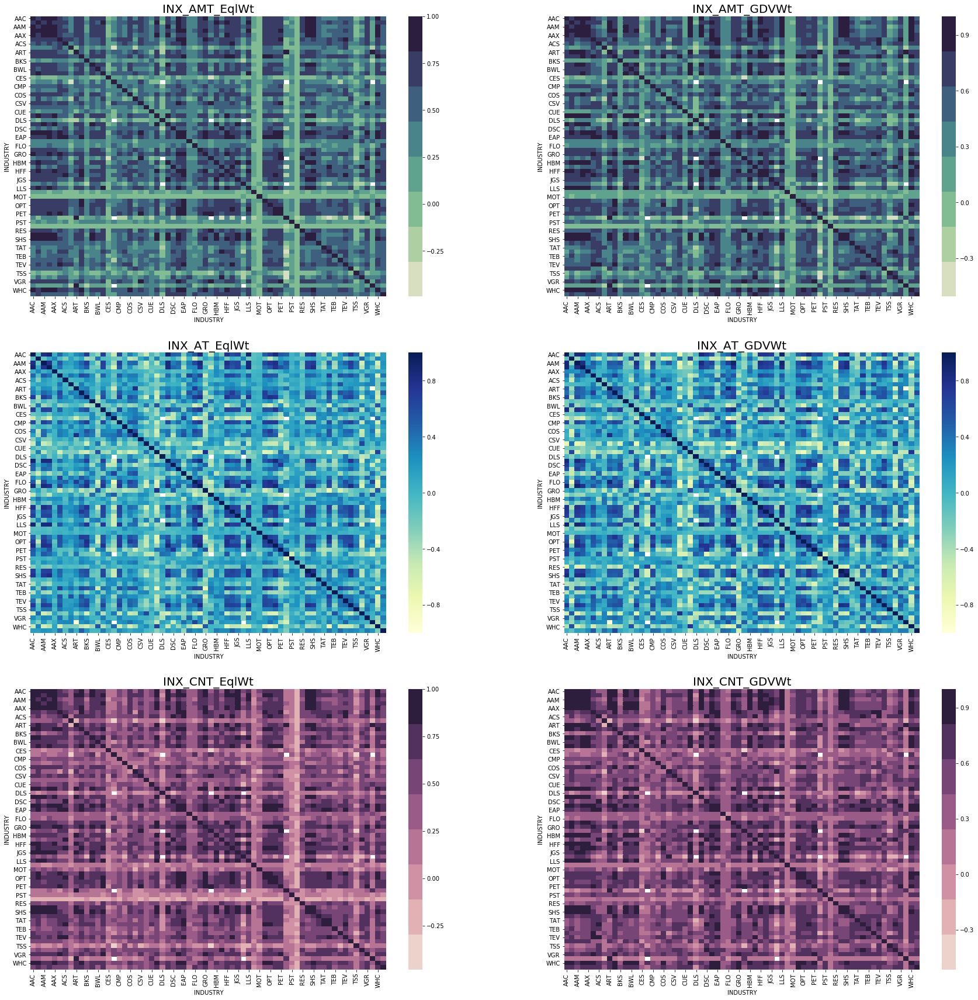

In [20]:
colors = [sns.cubehelix_palette(8, start=.5, rot=-.75),'YlGnBu',sns.cubehelix_palette(8)]
M = 2
N = 3
i = 1
plt.subplots(figsize = (30,30),nrows=N, ncols=M)

print('Industry Correlation on Different Measures\n')
print('Industries are extremely high-correlated with each other')

for i in range(1,M*N+1):
    plt.subplot(N,M,i)
    m = sorted(measures)[i-1]
    temp = country_unnormlize[["TXN_DATE","INDUSTRY",m]].pivot(index='TXN_DATE', columns='INDUSTRY', values=m).sort_index().corr()
    plt.title(m,fontsize=20)
    sns.heatmap(temp,cmap=colors[(math.floor((i+1)/2)-1)])

Industry Volatility on Different Measurements

INX varies little in most industries with narrow distribution. But there are a few exceptions.


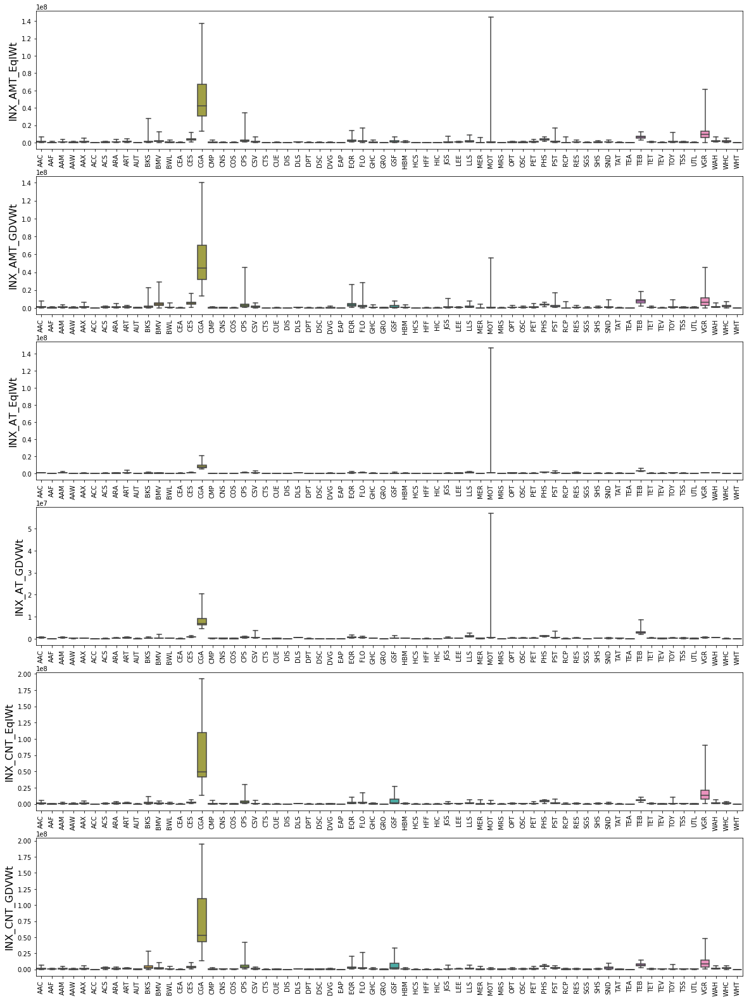

In [21]:
M = 1
N = 6
i = 1
plt.subplots(figsize = (20,28),nrows=N, ncols=M)

print('Industry Volatility on Different Measurements\n')
print('INX varies little in most industries with narrow distribution. But there are a few exceptions.')

for i in range(1,M*N+1):
    plt.subplot(N,M,i)
    m = sorted(measures)[i-1]
    ax = sns.boxplot(x="INDUSTRY", y= m, data=country_unnormlize, whis=np.inf)
    plt.xlabel('')
    plt.ylabel(m, fontsize=16)
    plt.xticks(rotation=90)

### Check Industries with High Volatility

Although they all have high volatility. The ways they fluctuate are quite different and interesting.

For example: 

CPS sees obvious seasonal effect.
CGA volatility seems to increase sharply after 2014.
Curious about things happened on MOT in 2013.
VGR increase more intensely after 2016.


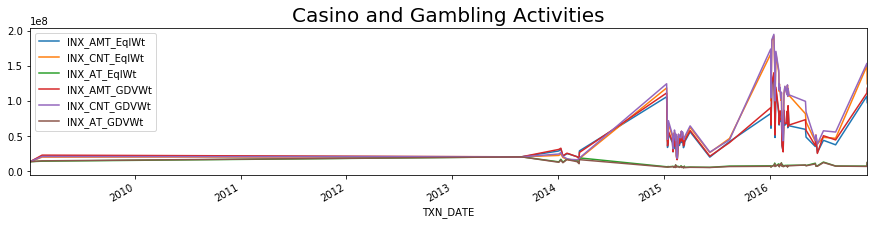

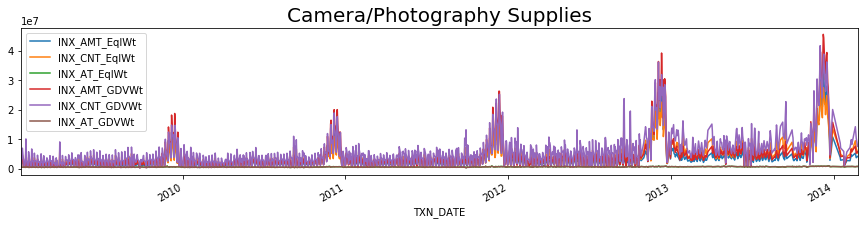

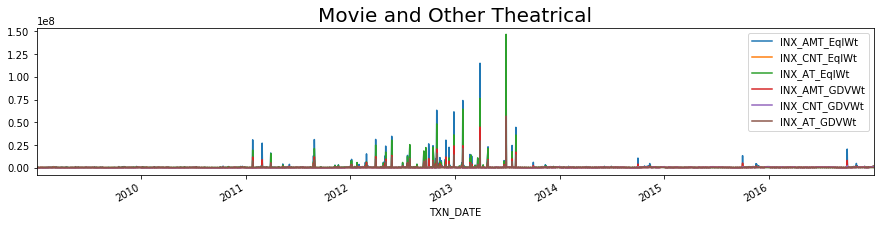

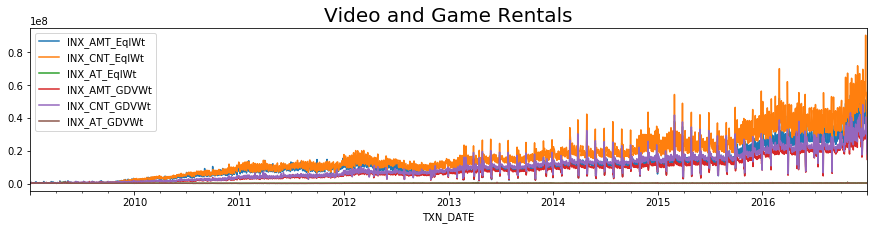

In [22]:
widespread_ind = ["CGA","CPS","MOT","VGR"]
print('Although they all have high volatility. The ways they fluctuate are quite different and interesting.\n')
print('For example: \n')
print('CPS sees obvious seasonal effect.')
print('CGA volatility seems to increase sharply after 2014.')
print('Curious about things happened on MOT in 2013.')
print('VGR increase more intensely after 2016.')
for ind in widespread_ind:
    country_unnormlize[country_unnormlize['INDUSTRY']==ind].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[1:,1:7].plot(figsize = (15,3))
    ind_x = ind_meta[ind_meta['Industry Code']==ind]['Industry Description'].item()
    plt.title(ind_x,fontsize = 20)

CGA and MOT demonstrate interesting patterns.Let us check what was happening.

CGA has too few data points, especially before 2015. Therefore, we can barely arrive any conclusion about industry volatility.
YEAR
2009     3
2013     1
2014     8
2015    29
2016    34
Name: TXN_DATE, dtype: int64
-------
MOT has good number of data points in each year. Therefore, disturbance around 2013 is worthy of checking in detail. 
YEAR
2009    364
2010    357
2011    340
2012    337
2013    339
2014    364
2015    365
2016    366
Name: TXN_DATE, dtype: int64
-------
It seems that disturbance is due to AMT/AT rather than CNT, meaning that in 2013 unit cost in MOT industry enormously increased with transaction volume almost unchanged.


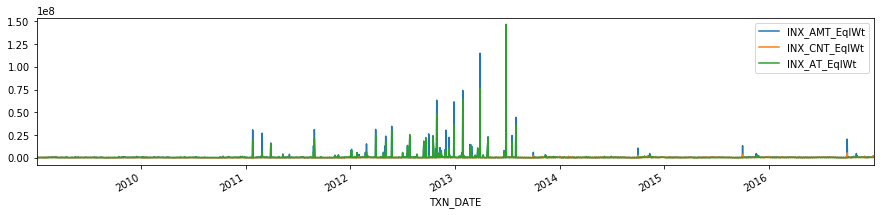

In [23]:
print('CGA and MOT demonstrate interesting patterns.Let us check what was happening.\n')
print('CGA has too few data points, especially before 2015. Therefore, we can barely arrive any conclusion about industry volatility.')
print(country_unnormlize[country_unnormlize['INDUSTRY']=='CGA'].groupby('YEAR').count()['TXN_DATE'])
print('-------')
print('MOT has good number of data points in each year. Therefore, disturbance around 2013 is worthy of checking in detail. ')
print(country_unnormlize[country_unnormlize['INDUSTRY']=='MOT'].groupby('YEAR').count()['TXN_DATE'])
print('-------')
plt.figure()
country_unnormlize[country_unnormlize['INDUSTRY']=='MOT'].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[1:,1:4].plot(figsize = (15,3))
print('It seems that disturbance is due to AMT/AT rather than CNT, meaning that in 2013 unit cost in MOT industry enormously increased with transaction volume almost unchanged.')

Let's then check which dates AMT witnessed volatility.


<strong>Dates with top INX_AMT_EqlWt:</strong>

TXN_DATE
2013-06-28    1.443123e+08
2013-03-29    1.148959e+08
2013-01-28    7.401034e+07
2012-10-29    6.331066e+07
2012-12-28    6.153864e+07
2013-08-01    4.455544e+07
2012-05-25    3.473513e+07
2012-03-30    3.131139e+07
2012-11-30    3.046588e+07
2012-10-01    2.640316e+07
2012-07-27    2.485184e+07
2013-07-19    2.467155e+07
2012-10-16    2.436878e+07
2012-05-04    2.394876e+07
2013-04-26    2.318382e+07
2012-12-11    2.264945e+07
2012-09-21    2.107427e+07
2012-10-30    1.761036e+07
2012-09-14    1.751461e+07
2012-10-31    1.686064e+07
Name: INX_AMT_EqlWt, dtype: float64


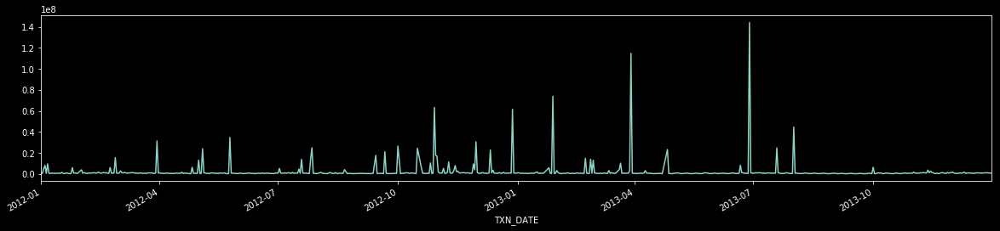

In [24]:
print('Let\'s then check which dates AMT witnessed volatility.')
with plt.style.context('dark_background'):
    country_unnormlize[(country_unnormlize['INDUSTRY']=='MOT') & (country_unnormlize['YEAR'].isin([2012,2013]))].set_index('TXN_DATE').sort_index()['INX_AMT_EqlWt'].plot(figsize = (20,4))
display(Markdown("<strong>Dates with top INX_AMT_EqlWt:</strong>"))
print(country_unnormlize[(country_unnormlize['INDUSTRY']=='MOT') & (country_unnormlize['YEAR'].isin([2012,2013]))].set_index('TXN_DATE').sort_values('INX_AMT_EqlWt',ascending = False)['INX_AMT_EqlWt'][:20])

### Check Major Industries I
* industries highly positively correlated with both retail sales and sales

/Users/miyainnyc/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


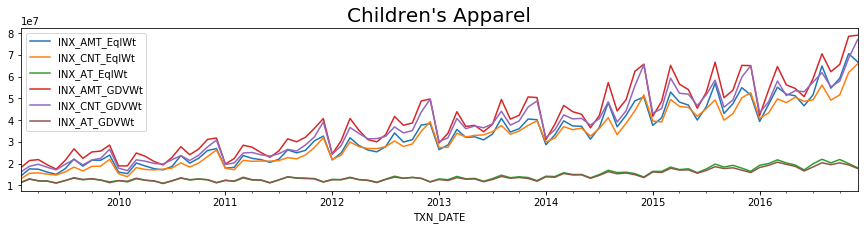

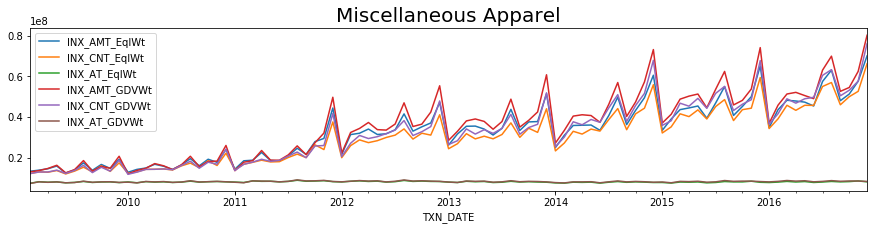

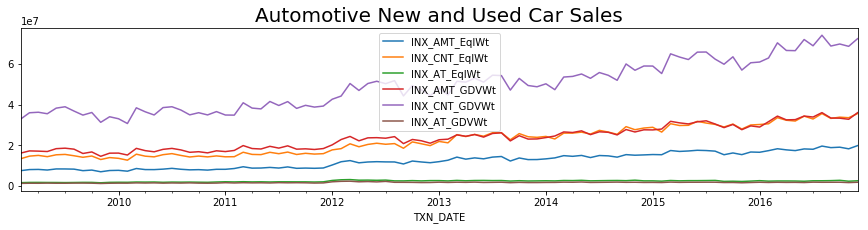

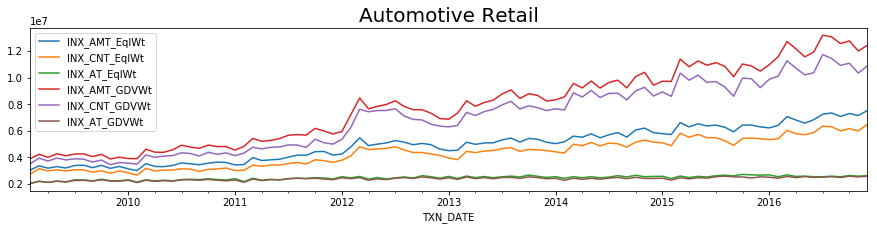

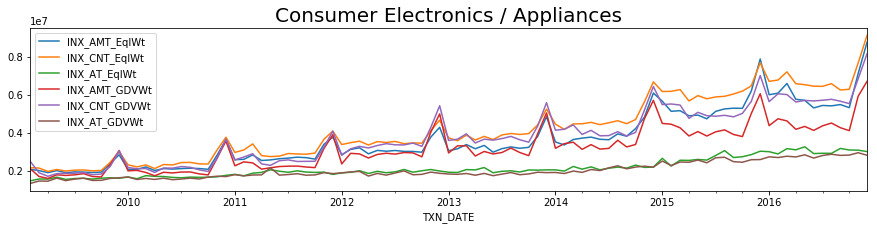

...

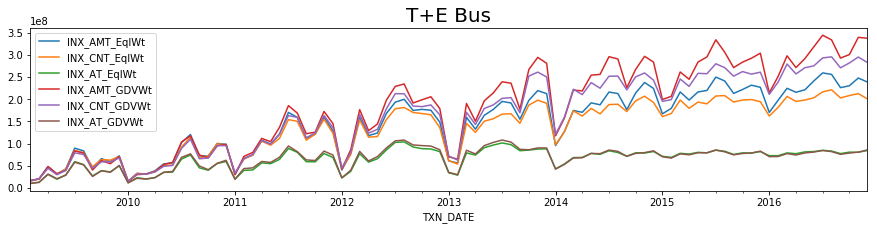

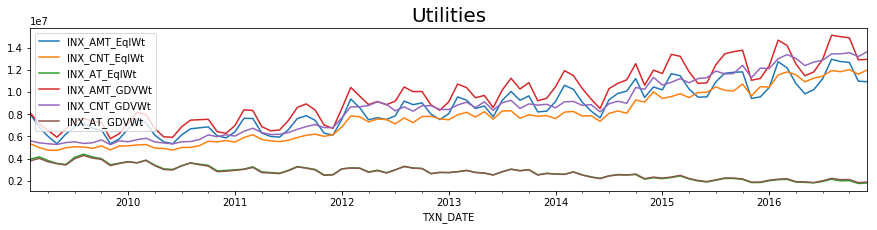

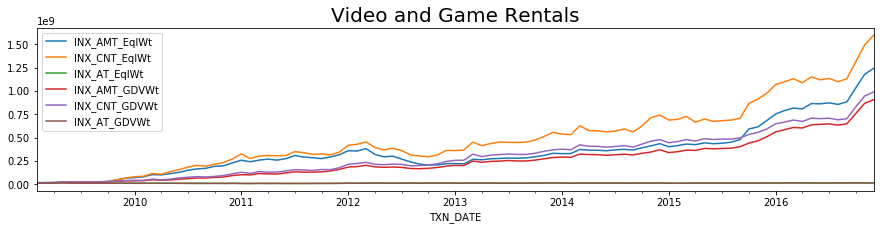

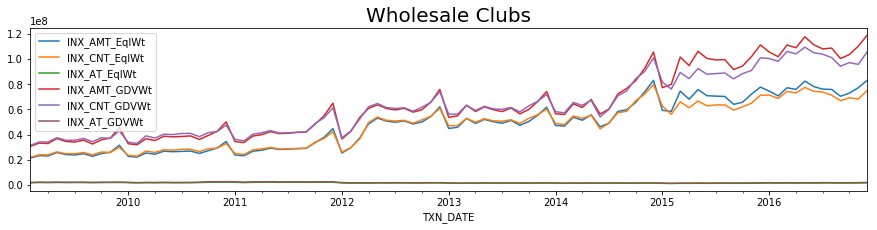

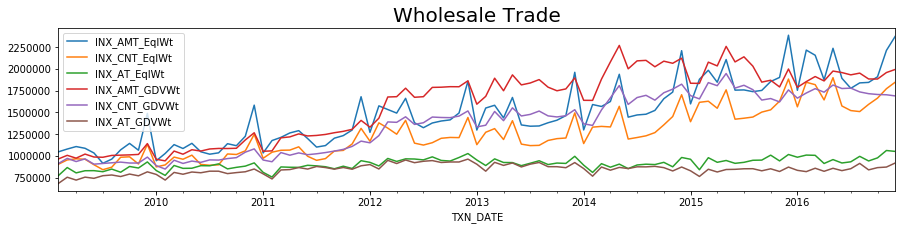

In [25]:
for ind in sorted(overlap1):
    country_monthly[country_monthly['INDUSTRY']==ind].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[1:,1:].plot(figsize = (15,3))
    ind_x = ind_meta[ind_meta['Industry Code']==ind]['Industry Description'].item()
    plt.title(ind_x,fontsize = 20)

### Check Major Industries II
* industries highly negatively correlated with both retail sales and sales in terms of AT

#### At the very begining of 2012:
* Family apparel major **DROP**
* Discount Department major **DROP**
* wholesale club major **DROP**
* entertainment major **INCREASE**
* Software major **INCREASE**


#### Seasonality:
* Family apparel **UNCHANGED** after 2012
* Entertainment and recreation **CHANGED** after 2012
* Wholesale **CHANGED** since the end of 2015

In [26]:
ind_meta[ind_meta['Industry Code'].isin(overlap2)]['Industry Description'].values

array(['Family Apparel',
       'Communications, Telecommunications, Cable Services',
       'Discount Department Stores',
       'Miscellaneous entertainment and recreation',
       'Software Production, Network Services and Data Processing',
       'Utilities', 'Wholesale Clubs'], dtype=object)

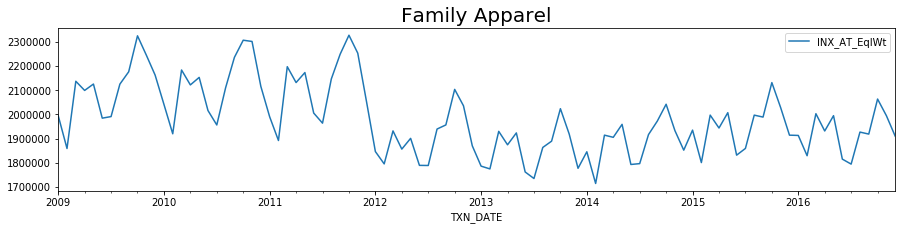

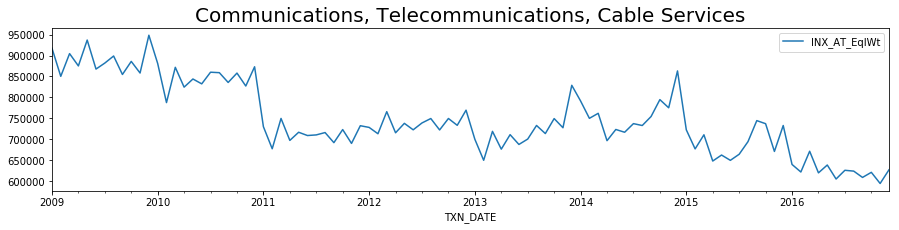

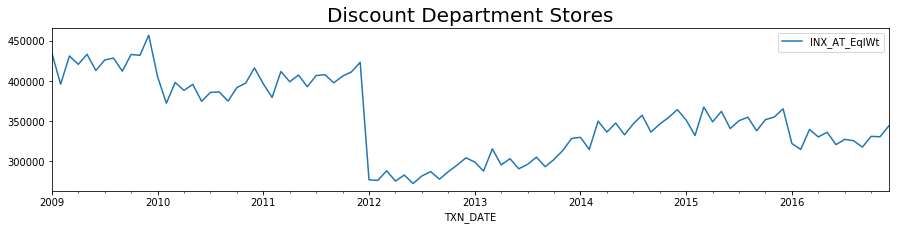

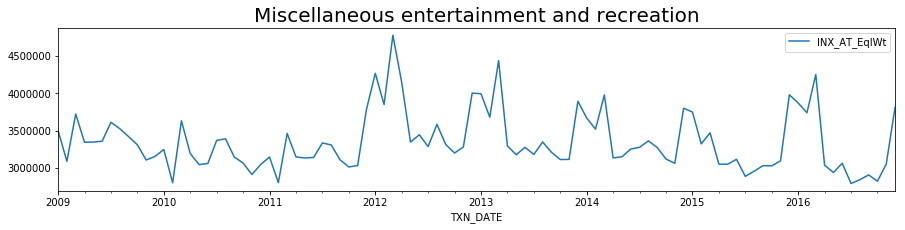

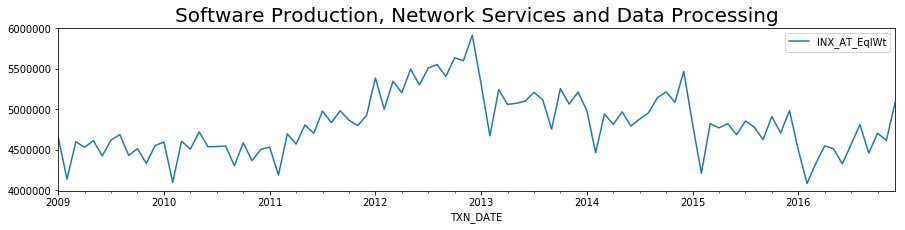

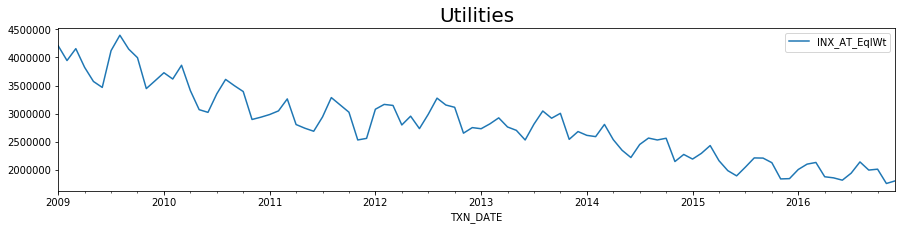

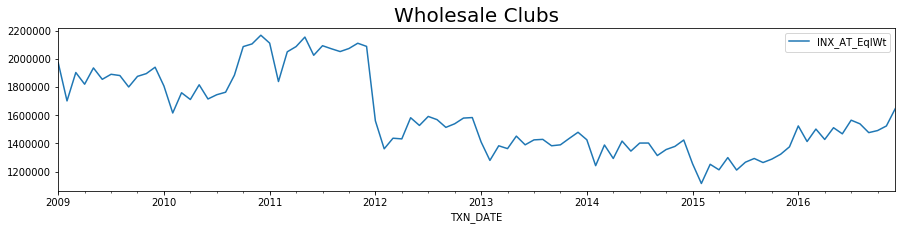

In [27]:
for ind in sorted(overlap2):
    country_monthly[country_monthly['INDUSTRY']==ind].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[:,[0,3]].plot(figsize = (15,3))
    ind_x = ind_meta[ind_meta['Industry Code']==ind]['Industry Description'].item()
    plt.title(ind_x,fontsize = 20)

### Interactive Chart
* Select Any Industry You are Interested to See the Trend

In [28]:
ind = widgets.Dropdown(
    options=sorted(country['Industry Description'].unique()),
    value="Children's Apparel",
    description='Industry:',
)

def plot_graph(ind):
    ind_x = ind_meta[ind_meta['Industry Description']==ind]['Industry Code'].item()
    country_monthly[country_monthly['INDUSTRY']==ind_x].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[1:,1:].plot(figsize = (15,3))
    plt.title(ind)

interactive(plot_graph, ind=ind)

A Jupyter Widget

### Top 10 Industries with Highest INX  (Daily Mediun Value Per Year )
* We only look at industries with enough data points. Industries, such as Casino, with few data points are dropped

In [29]:
display(Markdown('<strong>Video and Game Rentals has been ranking topest since 2010 \
                 in terms of AMT median.</strong>'))

year = widgets.Dropdown(
    options=sorted(country_unnormlize['YEAR'].unique()),
    description='Year:',
)

metrics = widgets.Dropdown(
    options=country_unnormlize.columns[2:8],
    description='Metrics:',
)

ind_to_leave_desc = [i for i in country_unnormlize['Industry Description'].unique() if i not in ind_drop_desc]

def display_top_industries(metrics,year):
    temp = pd.DataFrame(country_unnormlize[country_unnormlize['YEAR']==year][['Industry Description',metrics]].groupby('Industry Description')[metrics].apply(np.median)).loc[ind_to_leave_desc,:]
    print(temp.sort_values(metrics,ascending = False)[:10])
interactive(display_top_industries, metrics = metrics, year = year)

<strong>Video and Game Rentals has been ranking topest since 2010                  in terms of AMT median.</strong>

A Jupyter Widget

### Clustering on Industries

INX_AMT_GDVWt selected as metric

46 industries in 96 dimensions


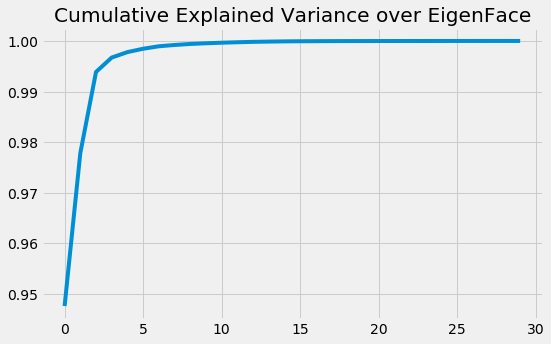

In [30]:
print('%s selected as metric\n' %measures[3])

industries = cluster_df_AMT.index 
temp = cluster_df_AMT
print('%d industries in %d dimensions'%(temp.shape[0],temp.shape[1]))

n_eigens=30
X_reduced = decomposition.PCA(n_components=n_eigens).fit(temp.values)
with plt.style.context('fivethirtyeight'):
    plt.figure(figsize=(8, 5));
    plt.title('Cumulative Explained Variance over EigenFace');
    plt.plot(X_reduced.explained_variance_ratio_.cumsum());
    
# 10 dimensions is the best
X_reduced = decomposition.PCA(n_components=10).fit_transform(temp.values)

K = range(1,40)
distortions = []
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(X_reduced)
    kmeanModel.fit(X_reduced)
    distortions.append(sum(np.min(cdist(X_reduced, kmeanModel.cluster_centers_, 'cosine'), axis=1)) / X_reduced.shape[0])

Text(0.5,1,'The Elbow Method showing the optimal k')

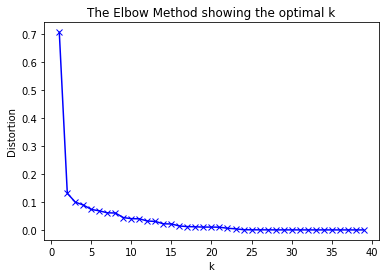

In [31]:
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')

In [32]:
%%opts Scatter (size=10)
%%opts Scatter [show_grid=True, width=450, height=350]
%%opts Scatter [tools=[bokeh.models.HoverTool(tooltips=[('industry', '@ind')])]]
style_opts = dict(size=5, cmap='Dark2')


# set clusters number as 5
n_clusters= 5
kmeans = KMeans(n_clusters= n_clusters).fit(temp.values)
kmeans_assign = kmeans.labels_

x = list(map(lambda x:x[0],decomposition.PCA(n_components=2).fit_transform(temp.values)))
y = list(map(lambda x:x[1],decomposition.PCA(n_components=2).fit_transform(temp.values)))
ind_2_desc = pd.DataFrame(temp['2009-01-01 00:00:00']).join(ind_meta.set_index('Industry Code'),how = 'left')['Industry Description']
temp_df = pd.DataFrame({'x':x,'y':y,"assign":kmeans_assign,'ind':ind_2_desc})

print('The following chart is interactive. Hover to see industry info.')
scatter = hv.Scatter(temp_df, kdims = ['x'],
                    vdims = ['y','assign','ind'])
scatter = bebi103.viz.adjust_range(scatter)
gb = scatter.groupby('assign')
overlay = gb.overlay()
overlay

The following chart is interactive. Hover to see industry info.


:NdOverlay   [assign]
   :Scatter   [x]   (y,assign,ind)

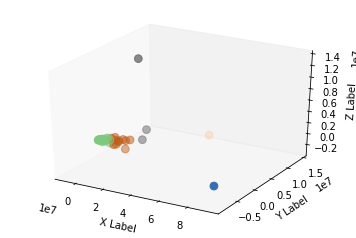

---------------
Followings are industry clusters.

Cluster 0:['Family Apparel' "Women's Apparel" 'Accommodations' 'Automotive Retail'
 'Consumer Electronics / Appliances' 'Computer / Software Stores'
 'Cosmetics and Beauty Services'
 'Communications, Telecommunications, Cable Services'
 'Discount Department Stores' 'Department Stores' 'Drug Store Chains'
 'Variety / General Merchandise Stores' 'Eating Places'
 'Giftware/Houseware/Card Shops' 'Grocery Stores'
 'Health Care and Social Assistance' 'Home Furnishings / Furniture'
 'Home Improvement Centers' 'Miscellaneous entertainment and recreation'
 'Movie and Other Theatrical' 'Maintenance and Repair Services'
 'Religious, Civic and Professional Organizations'
 'Sporting Goods / Apparel / Footwear' 'Shoe Stores'
 'Travel Agencies and Tour Operators' 'T+E Airlines' 'T+E Vehicle Rental'
 'Other Transportation Services' 'Utilities' 'Wholesale Trade']
Cluster 1:['Music and Videos']
Cluster 2:['Video and Game Rentals']
Cluster 3:["Children's

In [33]:
## 3D Map. Just for fun

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

x = list(map(lambda x:x[0],decomposition.PCA(n_components=3).fit_transform(temp.values)))
y = list(map(lambda x:x[1],decomposition.PCA(n_components=3).fit_transform(temp.values)))
z = list(map(lambda x:x[2],decomposition.PCA(n_components=3).fit_transform(temp.values)))

ax.scatter(x, y, z, s = 60, c=kmeans_assign, marker='o',cmap = 'Accent')
ax.grid(False)
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

plt.show()

print('---------------')
print('Followings are industry clusters.\n')
for i in range(5):
    print("Cluster %d:%s"%(i,temp_df[temp_df['assign']==i]['ind'].values))


<strong>It is interesting that the model                  separates Children's Apparel and Men's Apparel from Family Apparel and "Women's Apparel</strong>

Let us see what are those industries like:

Children and Men Apparel UNIT COST (AT) experienced notable increase after 2014 while Family, Women  Miscellaneous and Sports relatively constant.

In 2016 Christmas season, Men and Women Apparel experience unprecedented jump. What does it imply for our expectation of 2017 Christmas season? 


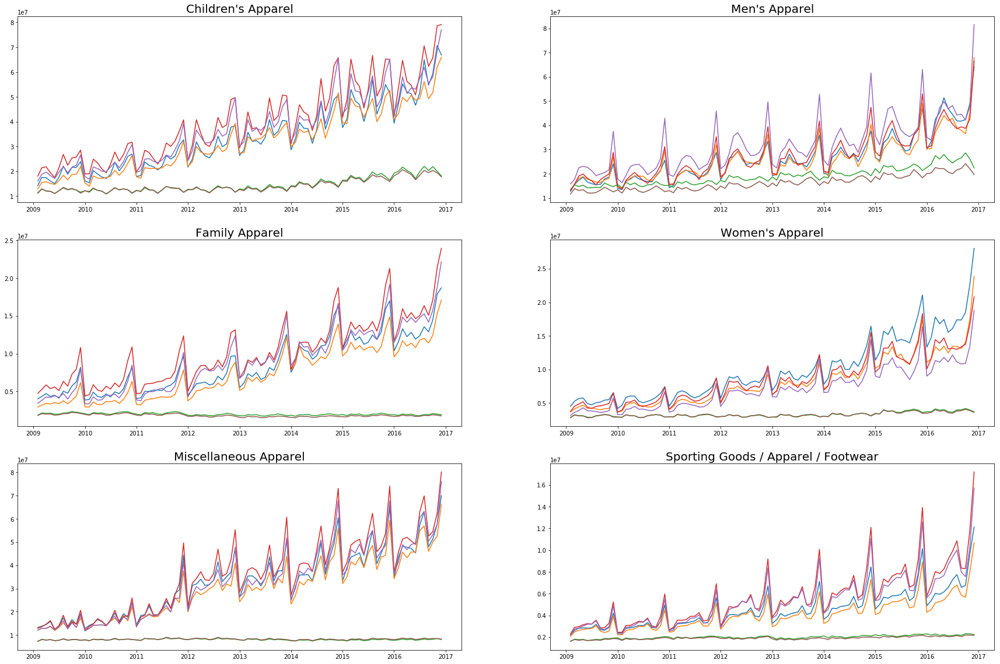

In [34]:
M = 2
N = 3
i = 1
plt.subplots(figsize = (30,20),nrows=N, ncols=M)

display(Markdown('<strong>It is interesting that the model \
                 separates Children\'s Apparel and Men\'s Apparel from Family Apparel and "Women\'s Apparel</strong>'))

print('Let us see what are those industries like:\n')
print('Children and Men Apparel UNIT COST (AT) experienced notable increase after 2014 while Family, Women  Miscellaneous and Sports relatively constant.\n' )
print('In 2016 Christmas season, Men and Women Apparel experience unprecedented jump. What does it imply for our expectation of 2017 Christmas season? ')

apparel = ["AAC","AAM",'AAF',"AAW",'AAX','SGS']
for i in range(1,M*N+1):
    ind = apparel[i-1]
    plt.subplot(N,M,i)
    plt.plot(country_monthly[country_monthly['INDUSTRY']==ind].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[1:,1:])
    ind_x = ind_meta[ind_meta['Industry Code']==ind]['Industry Description'].item()
    plt.title(ind_x,fontsize = 20)

In [35]:
print('We can arrive at the initial conclustion that industries can be classified into 5 groups based on INX data')
print('Clustering here is quite naive. Just an attempt try. ')
print('Let us try some other methods.')

We can arrive at the initial conclustion that industries can be classified into 5 groups based on INX data
Clustering here is quite naive. Just an attempt try. 
Let us try some other methods.


<strong>Monthly INX_AMT_GDVWt variation ratio </strong>selected as metric

46 industries in 96 dimensions

Variation Ratio across industries is much less correlated with each other.


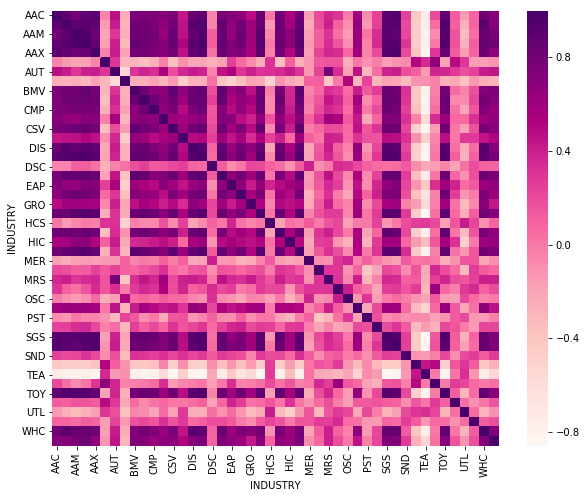

In [36]:
display(Markdown('<strong>Monthly {} variation ratio </strong>selected as metric'.format(measures[3])))

industries = cluster_df_AMT.index 
temp = cluster_df_AMT

print('%d industries in %d dimensions\n'%(temp.shape[0],temp.shape[1]))
print('Variation Ratio across industries is much less correlated with each other.')
# change rate
temp_rescale = temp.diff(axis=1).iloc[:,1:]/temp.iloc[:,1:]
plt.figure(figsize=(10, 8));
sns.heatmap(temp_rescale.T.corr(),cmap = 'RdPu')

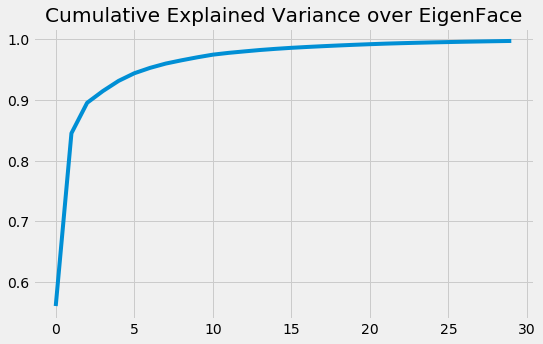

In [37]:
n_eigens=30
X_reduced = decomposition.PCA(n_components=n_eigens).fit(temp_rescale.values)
with plt.style.context('fivethirtyeight'):
    plt.figure(figsize=(8, 5));
    plt.title('Cumulative Explained Variance over EigenFace');
    plt.plot(X_reduced.explained_variance_ratio_.cumsum());
    
# 15 dimensions are the best
X_reduced = decomposition.PCA(n_components=15).fit_transform(temp_rescale.values)

K = range(1,40)
distortions = []
for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(X_reduced)
    kmeanModel.fit(X_reduced)
    distortions.append(sum(np.min(cdist(X_reduced, kmeanModel.cluster_centers_, 'cosine'), axis=1)) / X_reduced.shape[0])

We will use as many clustering techniques as possible this time.



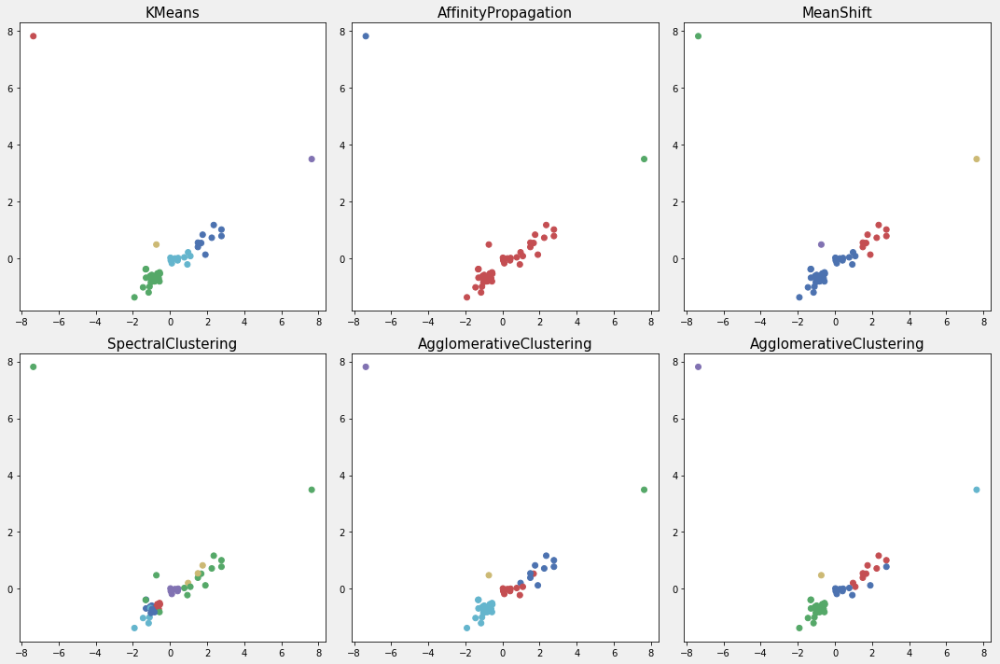

In [38]:
print('We will use as many clustering techniques as possible this time.\n')

def plot_clusters(X_reduced, algorithm, args, kwds):
    labels = algorithm(*args, **kwds).fit_predict(X_reduced)
    palette = sns.color_palette('deep', np.unique(labels).max() + 1)
    colors = [palette[x] if x >= 0 else (0.0, 0.0, 0.0) for x in labels]
    x = list(map(lambda x:x[0],decomposition.PCA(n_components=2).fit_transform(temp_rescale.values)))
    y = list(map(lambda x:x[1],decomposition.PCA(n_components=2).fit_transform(temp_rescale.values)))
    plt.scatter(x, y, c=colors)
    plt.title(str(algorithm.__name__),fontsize=15)
    return labels
M = 2
N = 3
i = 1
with plt.style.context('fivethirtyeight'):
    fig, axes = plt.subplots(figsize = (15,10),nrows=N, ncols=M)

plt.subplot(2,3,1)
kmeans_l = plot_clusters(X_reduced, cluster.KMeans, (), {'n_clusters':6})
plt.subplot(2,3,2)
AP_l = plot_clusters(X_reduced, cluster.AffinityPropagation, (), {'damping':0.999})
plt.subplot(2,3,3)
MS_l = plot_clusters(X_reduced, cluster.MeanShift, (), {})
plt.subplot(2,3,4)
SC_l = plot_clusters(X_reduced, cluster.SpectralClustering, (), {'n_clusters':6})
plt.subplot(2,3,5)
AC_l = plot_clusters(X_reduced, cluster.AgglomerativeClustering, (), {'n_clusters':7, 'linkage':'ward'})
plt.subplot(2,3,6)
AC_l_2 = plot_clusters(X_reduced, cluster.AgglomerativeClustering, (), {'n_clusters':7, 'linkage':'complete'})

fig.tight_layout()

In [39]:
assigns_ = [kmeans_l,AP_l,MS_l,SC_l,AC_l,AC_l_2]
algos = ['Kmeans','AffinityPropagation','MeanShift','SpectralClustering',
         'AgglomerativeClustering-wardLinkage','AgglomerativeClustering-completeLinkage']

algo_2_ass = {i:v for i, v in zip(algos, assigns_)}
ind_2_desc = pd.DataFrame(temp_rescale['2009-02-01 00:00:00']).join(ind_meta.set_index('Industry Code'),how = 'left')['Industry Description']

algorithm = widgets.Dropdown(
    options=sorted(algos),
    value='AgglomerativeClustering-wardLinkage',
    description='Algorithms:',
)


cluster_assign = widgets.Dropdown(
    options=list(set(algo_2_ass[algorithm.value])))

def checkAssign(algorithm,cluster_assign):
    display(Markdown('<strong>{}</strong>'.format(algorithm)))
    display(Markdown('<strong>There are {} clusters generated.</strong>'.format(len(list(set(algo_2_ass[algorithm]))))))
    temp_df = pd.DataFrame({"assign":algo_2_ass[algorithm],'ind':ind_2_desc})
    for i in range(len(list(set(algo_2_ass[algorithm])))):
        ind = temp_df[temp_df['assign']==i]['ind'].values
        print("Cluster %d:%s\n"%(i,ind))
    ax = pd.DataFrame(country_monthly[country_monthly['INDUSTRY'].isin(temp_df[temp_df['assign']==cluster_assign].index)].set_index(['INDUSTRY','TXN_DATE'])['INX_AMT_GDVWt']).reset_index().pivot(index='TXN_DATE', columns='INDUSTRY', values='INX_AMT_GDVWt').sort_index().plot(figsize = (15,4))
    #ax.legend([])
    plt.title('%s-Cluster: %s'%(algorithm, cluster_assign))
    
interactive(checkAssign, algorithm=algos,cluster_assign = cluster_assign)

A Jupyter Widget

I personally like SpectralClustering most: 
 1. Inustries are more evenly distributed in clusters.
 2. similarity among industries within clusters is high.

Here is the result from SpectralClustering:

Cluster 0:['Automotive Retail' 'Drug Store Chains'
 'Health Care and Social Assistance'
 'Miscellaneous entertainment and recreation'
 'Maintenance and Repair Services' 'Optical' 'Office Supply Chains'
 'Software Production, Network Services and Data Processing'
 'Other Transportation Services' 'Video and Game Rentals']

Cluster 1:['Family Apparel' "Men's Apparel" "Women's Apparel" 'Book Stores'
 'Music and Videos' 'Discount Department Stores' 'Department Stores'
 'Variety / General Merchandise Stores' 'Giftware/Houseware/Card Shops'
 'Jewelry and Giftware' 'Movie and Other Theatrical'
 'Professional Sports Teams'
 'Religious, Civic and Professional Organizations'
 'Sporting Goods / Apparel / Footwear' 'Toy Stores']

Cluster 2:['Cosmetics and Beauty Services'
 'Communications, Telecommun

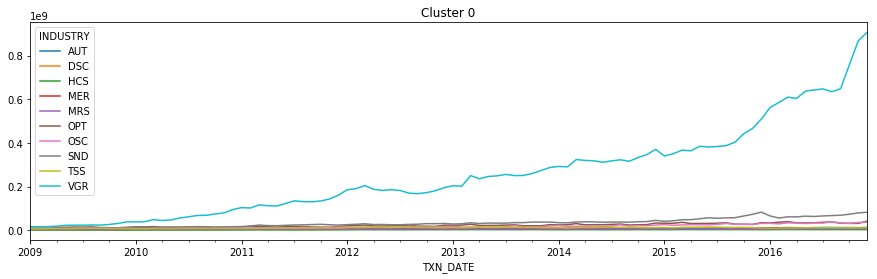

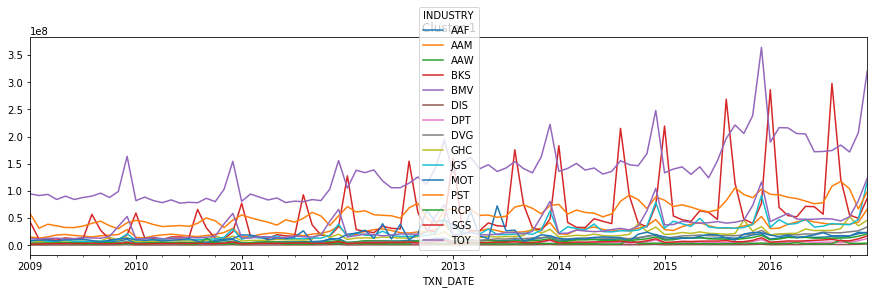

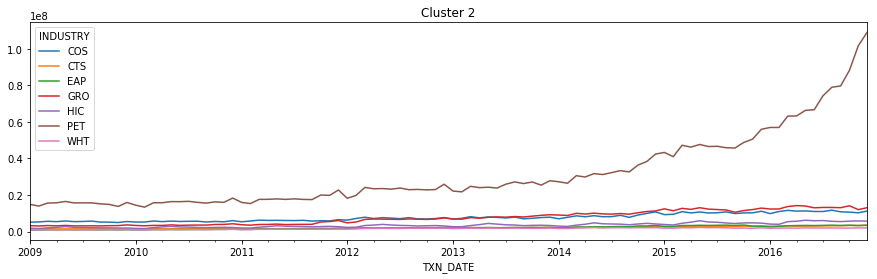

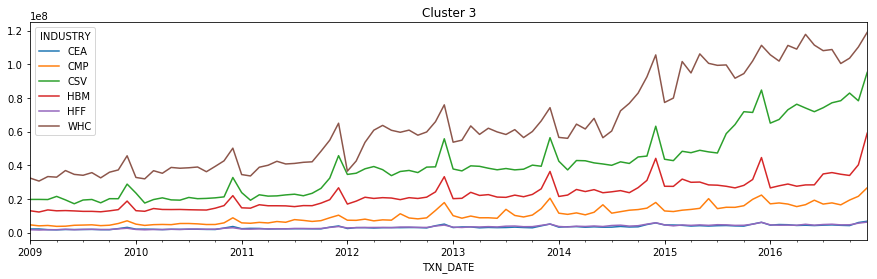

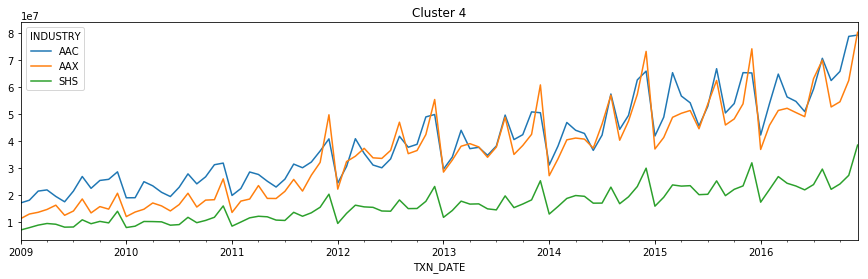

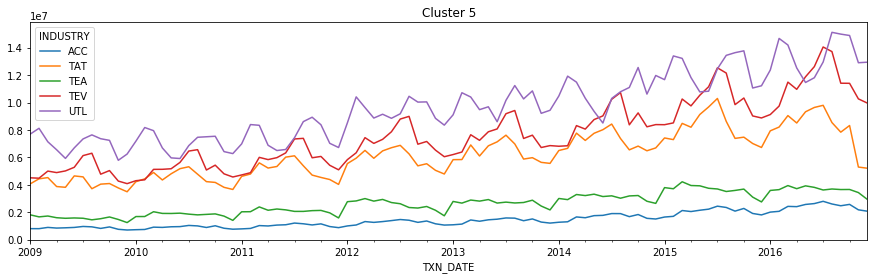

In [40]:
print("I personally like SpectralClustering most: \n \
1. Inustries are more evenly distributed in clusters.\n \
2. similarity among industries within clusters is high.\n")

print('Here is the result from SpectralClustering:\n')

temp_df = pd.DataFrame({"assign":algo_2_ass['SpectralClustering'],'ind':ind_2_desc})

for i in range(len(list(set(algo_2_ass['SpectralClustering'])))):
    ind = temp_df[temp_df['assign']==i]['ind'].values
    print("Cluster %d:%s\n"%(i,ind))
    ax = pd.DataFrame(country_monthly[country_monthly['INDUSTRY'].isin(temp_df[temp_df['assign']==i].index)].set_index(['INDUSTRY','TXN_DATE'])['INX_AMT_GDVWt']).reset_index().pivot(index='TXN_DATE', columns='INDUSTRY', values='INX_AMT_GDVWt').sort_index().plot(figsize = (15,4))
    #ax.legend([])
    plt.title('Cluster %s'%i)

### LSTM Predict Major Industries

In [41]:
print('We are interested in predicting major industries including %s %s'%(ind_high_desc,ind_high_desc1))

We are interested in predicting major industries including ["Children's Apparel" 'Miscellaneous Apparel'
 'Automotive New and Used Car Sales' 'Automotive Retail'
 'Consumer Electronics / Appliances' 'Computer / Software Stores'
 'Cosmetics and Beauty Services'
 'Communications, Telecommunications, Cable Services' 'Drug Store Chains'
 'Variety / General Merchandise Stores' 'Eating Places'
 'Giftware/Houseware/Card Shops' 'Grocery Stores'
 'Health Care and Social Assistance' 'Home Furnishings / Furniture'
 'Home Improvement Centers' 'Miscellaneous entertainment and recreation'
 'Maintenance and Repair Services' 'Optical' 'Office Supply Chains'
 'Software Production, Network Services and Data Processing' 'T+E Airlines'
 'T+E Bus' 'Utilities' 'Video and Game Rentals' 'Wholesale Clubs'
 'Wholesale Trade'] ['Maintenance and Repair Services']


In [42]:
print('MRS')
print(country_monthly[country_monthly['INDUSTRY']=='MRS'].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[:,:].join(Retail.set_index('Date').sort_index()).corr().iloc[-1,:])
print('OSC')
print(country_monthly[country_monthly['INDUSTRY']=='OSC'].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[:,:].join(coreRetail.set_index('Date').sort_index()).corr().iloc[-1,:])
print('HIC')
print(country_monthly[country_monthly['INDUSTRY']=='HIC'].sort_values('TXN_DATE').set_index('TXN_DATE').iloc[:,:].join(coreRetail.set_index('Date').sort_index()).corr().iloc[-1,:])

MRS
INX_AMT_EqlWt    0.928020
INX_CNT_EqlWt    0.903250
INX_AT_EqlWt     0.905929
INX_AMT_GDVWt    0.903959
INX_CNT_GDVWt    0.919144
INX_AT_GDVWt     0.902017
Sales            1.000000
Name: Sales, dtype: float64
OSC
INX_AMT_EqlWt    0.923369
INX_CNT_EqlWt    0.951082
INX_AT_EqlWt     0.934857
INX_AMT_GDVWt    0.946211
INX_CNT_GDVWt    0.957267
INX_AT_GDVWt     0.920946
Sales            1.000000
Name: Sales, dtype: float64
HIC
INX_AMT_EqlWt    0.954889
INX_CNT_EqlWt    0.951901
INX_AT_EqlWt     0.952248
INX_AMT_GDVWt    0.919175
INX_CNT_GDVWt    0.921883
INX_AT_GDVWt     0.906954
Sales            1.000000
Name: Sales, dtype: float64


In [43]:
print('We are interesed in predicting [MRS: INX_AMT_EqlWt], [OSC: INX_CNT_EqlWt],[HIC:INX_AMT_EqlWt]')

We are interesed in predicting [MRS: INX_AMT_EqlWt], [OSC: INX_CNT_EqlWt],[HIC:INX_AMT_EqlWt]


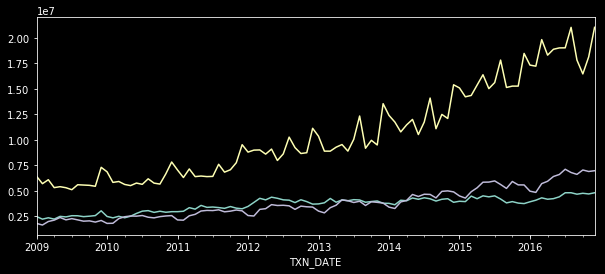

In [44]:
with plt.style.context('dark_background'):
    country_monthly[country_monthly['INDUSTRY']=='MRS'].sort_values('TXN_DATE').set_index('TXN_DATE').join(Retail.set_index('Date').sort_index())['INX_AMT_EqlWt'].plot(figsize = (10,4))
    country_monthly[country_monthly['INDUSTRY']=='OSC'].sort_values('TXN_DATE').set_index('TXN_DATE').join(Retail.set_index('Date').sort_index())['INX_CNT_EqlWt'].plot()
    country_monthly[country_monthly['INDUSTRY']=='HIC'].sort_values('TXN_DATE').set_index('TXN_DATE').join(Retail.set_index('Date').sort_index())['INX_AMT_EqlWt'].plot()

### LSTM

https://papers.ssrn.com/sol3/papers.cfm?abstract_id=3051735

# B. STATE LEVEL

In [45]:
print("Before do any analysis, let\'s check what data looks like.\n")
state['YEAR'] = list(map(lambda x: x.year,state['TXN_DATE']))
print('Many industries only have few data points.\n')
print(pd.DataFrame(state.groupby(['INDUSTRY']).count()['TXN_DATE']).sort_values('TXN_DATE').iloc[:10])
print()
print('Some industries only have a few states\' records.\n')
print(pd.DataFrame(state.groupby('INDUSTRY').STATE_PROVINCE_CODE.nunique()).sort_values('STATE_PROVINCE_CODE')[:10])

Before do any analysis, let's check what data looks like.

Many industries only have few data points.

          TXN_DATE
INDUSTRY          
TAT              8
EQR             10
CPS             10
TSS             13
TET            182
HCS            295
ACS            493
BMV           1203
CSV           1727
OPT           1728

Some industries only have a few states' records.

          STATE_PROVINCE_CODE
INDUSTRY                     
CPS                         1
UTL                         1
TAT                         1
TSS                         1
ACS                         1
TET                         1
SND                         1
EQR                         1
BMV                         2
CSV                         2


In [46]:
#with open('list_geo.pickle', 'wb') as handle:
    #pickle.dump(list_geo, handle, protocol=pickle.HIGHEST_PROTOCOL)
#geolocator = Nominatim()
#list_geo = {}
#for i in state['STATE_PROVINCE_CODE'].unique():
    #location = geolocator.geocode(i+',US',timeout=10)
    #list_geo[i] = (location.latitude, location.longitude)

In [47]:
import pickle
import warnings
warnings.filterwarnings('ignore')

with open('list_geo.pickle', 'rb') as handle:
    list_geo = pickle.load(handle)

temp = pd.DataFrame(list_geo).T.reset_index()
temp = temp.rename(columns={'index':"STATE_PROVINCE_CODE",0: 'lat', 1: 'long'})
state_temp = state.merge(temp)

m = Basemap(projection='cyl',llcrnrlat=20,urcrnrlat=50,\
            llcrnrlon=-130,urcrnrlon=-60,lat_ts=20,resolution='i')

inds_to_chose = state.merge(ind_meta.rename(columns = {"Industry Code":'INDUSTRY'}))['Industry Description'].unique()

In [48]:
year = widgets.Dropdown(
    options=[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017],
    value=2016,
    description='year:',
)

industry = widgets.Dropdown(
    options=sorted(inds_to_chose),
    value='Communications, Telecommunications, Cable Services',
    description='industry:',
)

metrics = widgets.Dropdown(
    options=sorted(measures[:6]),
    value='INX_AMT_EqlWt',
    description='metrics:',
)

def geo_graph(year, industry, metrics):
    display(Markdown("<strong>Size: Median Value</strong>"))
    display(Markdown("<strong>Color: Correlation with Core Sales</strong>"))
    
    ind = ind_meta[ind_meta['Industry Description']==industry]['Industry Code'].item()
    col = [metrics,'STATE_PROVINCE_CODE']
    
    cor_state = pd.DataFrame(state[(state['YEAR']==year) & (state['INDUSTRY']==ind)][[metrics,'STATE_PROVINCE_CODE','TXN_DATE']].groupby(['TXN_DATE','STATE_PROVINCE_CODE']).median().reset_index().pivot(index='TXN_DATE', columns="STATE_PROVINCE_CODE", values=metrics).reset_index().merge(coreRetail.rename(columns = {'Date':'TXN_DATE'})).set_index('TXN_DATE').corr().iloc[:-1,-1]).reset_index().rename(columns = {'index':'STATE_PROVINCE_CODE','Sales':"Correlation"})
    me_state = state[(state['YEAR']==year) & (state['INDUSTRY']==ind)][col].groupby('STATE_PROVINCE_CODE').median().reset_index().rename(columns = {metrics:'me_'+metrics}).merge(temp)
    
    state_scatter = me_state.merge(cor_state)
    
    plt.figure(figsize=(20,8))
    #m.drawcoastlines()
    m.drawcountries()
    m.drawstates()
    m.drawmapboundary(fill_color='silver')
    plt.title("In %s, %s Median and \nCorrelation with CoreSales \nby state for %s industry"%(year, metrics, industry),fontsize=18)
    x,y = m(state_scatter.long.values, state_scatter.lat.values)   # This is the step that transforms the data into the map's projection
    m.scatter(x, y,c = state_scatter["Correlation"], s=(state_scatter['me_'+metrics]/10), cmap="Blues")
    ax.axis('off')
    plt.colorbar(label="Standard Deviation")
    plt.show()

interactive(geo_graph,year=year, industry = industry, metrics = metrics)

A Jupyter Widget

In [52]:
year = widgets.Dropdown(
    options=[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017],
    value=2016,
    description='year:',
)

industry = widgets.Dropdown(
    options=sorted(inds_to_chose),
    value='Communications, Telecommunications, Cable Services',
    description='industry:',
)

metrics = widgets.Dropdown(
    options=sorted(measures[:6]),
    value='INX_AMT_EqlWt',
    description='metrics:',
)

def geo_graph(year, industry, metrics):
    display(Markdown("<strong>Size: Median Value</strong>"))
    display(Markdown("<strong>Color: Correlation with Core Sales</strong>"))
    
    ind = ind_meta[ind_meta['Industry Description']==industry]['Industry Code'].item()
    col = [metrics,'STATE_PROVINCE_CODE']
    
    cor_state = pd.DataFrame(state[(state['YEAR']==year) & (state['INDUSTRY']==ind)][[metrics,'STATE_PROVINCE_CODE','TXN_DATE']].groupby(['TXN_DATE','STATE_PROVINCE_CODE']).median().reset_index().pivot(index='TXN_DATE', columns="STATE_PROVINCE_CODE", values=metrics).reset_index().merge(coreRetail.rename(columns = {'Date':'TXN_DATE'})).set_index('TXN_DATE').corr().iloc[:-1,-1]).reset_index().rename(columns = {'index':'STATE_PROVINCE_CODE','Sales':"Correlation"})
    me_state = state[(state['YEAR']==year) & (state['INDUSTRY']==ind)][col].groupby('STATE_PROVINCE_CODE').median().reset_index().rename(columns = {metrics:'me_'+metrics}).merge(temp)
    
    state_scatter = me_state.merge(cor_state)
    
    plt.figure(figsize=(20,8))
    #m.drawcoastlines()
    m.drawcountries()
    m.drawstates()
    m.drawmapboundary(fill_color='silver')
    plt.title("In %s, %s Median and \nCorrelation with CoreSales \nby state for %s industry"%(year, metrics, industry),fontsize=18)
    x,y = m(state_scatter.long.values, state_scatter.lat.values)   # This is the step that transforms the data into the map's projection
    m.scatter(x, y,c = state_scatter["Correlation"], s=(state_scatter['me_'+metrics]/10), cmap="Blues")
    ax.axis('off')
    
    for label, a, b in zip(state_scatter['STATE_PROVINCE_CODE'], x, y):
        plt.annotate(
            label,xy=(a, b), xytext=(-0, 0), size=25,color = 'black',alpha = 0.6,fontname='Helvetica',#weight='bold',
            textcoords='offset points', horizontalalignment='center',
            verticalalignment='center')#),
            #bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.9,)#),
            ##arrowprops=dict(arrowstyle = '->',connectionstyle='arc3,rad=0'))
    
        
    plt.colorbar(label="Standard Deviation",fraction=0.015, pad=0.05)
    plt.show()

interactive(geo_graph,year=year, industry = industry, metrics = metrics)

A Jupyter Widget

In [ ]:
year = widgets.Dropdown(
    options=[2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017],
    value=2017,
    description='year:',
)

industry = widgets.Dropdown(
    options=sorted(inds_to_chose),
    value='Accommodations',
    description='industry:',
)

metrics = widgets.Dropdown(
    options=sorted(measures[:6]),
    value='INX_AMT_EqlWt',
    description='metrics:',
)

def geo_graph(year, industry, metrics):
    display(Markdown("<strong>Size: Median Value</strong>"))
    display(Markdown("<strong>Color: Standard Deviation</strong>"))
    
    ind = ind_meta[ind_meta['Industry Description']==industry]['Industry Code'].item()
    col = [metrics,'STATE_PROVINCE_CODE']
    std_state = state[(state['YEAR']==year) & (state['INDUSTRY']==ind)][col].groupby('STATE_PROVINCE_CODE').std().reset_index().rename(columns = {metrics:
                                                                                                                                    "std_"+metrics}).merge(temp)
    me_state = state[(state['YEAR']==year) & (state['INDUSTRY']==ind)][col].groupby('STATE_PROVINCE_CODE').median().reset_index().rename(columns = {metrics:'me_'+metrics}).merge(temp)
    
    state_scatter = me_state.merge(std_state)
    
    plt.figure(figsize=(20,8))
    m.drawcoastlines()
    m.drawcountries()
    m.drawmapboundary(fill_color='silver')
    plt.title("In %s, %s by state for %s industry"%(year, metrics, industry),fontsize=18)
    x,y = m(state_scatter.long.values, state_scatter.lat.values)   # This is the step that transforms the data into the map's projection
    m.scatter(x, y,c = state_scatter['std_'+metrics], s=(state_scatter['me_'+metrics]/10), cmap="Reds")
    ax.axis('off')
    plt.colorbar(label="Standard Deviation")
    plt.show()

interactive(geo_graph,year=year, industry = industry, metrics = metrics)

In [ ]:
for ind in state['INDUSTRY'].unique():
    for m in measures[:6]:
        print('In terms of %s and %s industry.'%(m,ind))
        temp = state[state['INDUSTRY']==ind].sort_values('TXN_DATE').groupby(['STATE_PROVINCE_CODE','TXN_DATE']).median().reset_index().pivot(index='TXN_DATE', columns="STATE_PROVINCE_CODE", values=m).reset_index()
        t = coreRetail.rename(columns = {'Date':'TXN_DATE'}).merge(temp).set_index('TXN_DATE').corr()
        print(t[abs(t['Sales'])>=0.8].iloc[1:,:1].sort_values('Sales',ascending = False))

# C. COUNTY LEVEL